## PyGMTSAR SBAS and PSI Analyses: Central Europe 2023

This exploration reproduces the findings shared in the following paper: [Integration of satellite SAR and optical acquisitions for the characterization of the Lake Sarez landslides in Tajikistan](https://www.researchgate.net/publication/378176884_Integration_of_satellite_SAR_and_optical_acquisitions_for_the_characterization_of_the_Lake_Sarez_landslides_in_Tajikistan).

The PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, among others, are my open-source projects developed in my free time. I hold a Master's degree in STEM, specializing in radio physics. In 2004, I received the first prize in the All-Russian Physics Competition for significant results in forward and inverse modeling for nonlinear optics and holography. These skills are also applicable to modeling Gravity, Magnetic, and Thermal fields, as well as satellite interferometry processing. With 20 years of experience as a data scientist and software developer, I have contributed to scientific and industrial development, working on government contracts, university projects, and with companies like LG Corp and Google Inc.

You can support my work on [Patreon](https://www.patreon.com/pechnikov), where I share updates on my projects, publications, use cases, examples, and other useful information. For research and development services and support, please visit my profile on the freelance platform [Upwork](https://www.upwork.com).

### Resources
- Google Colab Pro notebooks and articles on [Patreon](https://www.patreon.com/pechnikov),
- Google Colab notebooks on [GitHub](https://github.com),
- Docker Images on [DockerHub](https://hub.docker.com),
- Geological Models on [YouTube](https://www.youtube.com),
- VR/AR Geological Models on [GitHub](https://github.com),
- Live updates and announcements on [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/).

© Alexey Pechnikov, 2024

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Google Colab Installation

Install PyGMTSAR and required GMTSAR binaries (including SNAPHU)

In [1]:
import platform, sys, os

"""
if 'google.colab' in sys.modules:
    # install PyGMTSAR stable version from PyPI
    !{sys.executable} -m pip install -q pygmtsar
    # alternatively, nstall PyGMTSAR development version from GitHub
    #!{sys.executable} -m pip install -Uq git+https://github.com/mobigroup/gmtsar.git@pygmtsar2#subdirectory=pygmtsar
    # use PyGMTSAR Google Colab installation script to install binary dependencies
    # script URL: https://github.com/AlexeyPechnikov/pygmtsar/blob/pygmtsar2/pygmtsar/pygmtsar/data/google_colab.sh
    import importlib.resources as resources
    with resources.as_file(resources.files('pygmtsar.data') / 'google_colab.sh') as google_colab_script_filename:
        !sh {google_colab_script_filename}
    # enable custom widget manager as required by recent Google Colab updates
    from google.colab import output
    output.enable_custom_widget_manager()
    # initialize virtual framebuffer for interactive 3D visualization; required for headless environments
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()
"""

# specify GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/opt/homebrew/Cellar/gmtsar/6.5/bin'
    %env PATH {PATH}

# display PyGMTSAR version
from pygmtsar import __version__
__version__

env: PATH=/opt/anaconda3/envs/msg2sar/bin:/opt/anaconda3/condabin:/opt/homebrew/bin:/opt/homebrew/sbin:/Library/Frameworks/Python.framework/Versions/3.12/bin:/Library/Frameworks/Python.framework/Versions/3.13/bin:/usr/local/bin:/System/Cryptexes/App/usr/bin:/usr/bin:/bin:/usr/sbin:/sbin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/local/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/appleinternal/bin:/opt/anaconda3/bin:/opt/anaconda3/condabin:/opt/homebrew/bin:/opt/homebrew/sbin:/Library/Frameworks/Python.framework/Versions/3.12/bin:/Library/Frameworks/Python.framework/Versions/3.13/bin:/usr/local/bin:/System/Cryptexes/App/usr/bin:/usr/bin:/bin:/usr/sbin:/sbin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/local/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/bin:/var/run/com.apple.security.cryptexd/codex.system/bootstrap/usr/appleinternal/bin

'2024.8.30.post5'

## Load and Setup Python Modules

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from dask.distributed import Client
import dask
import warnings
warnings.filterwarnings('ignore')

In [3]:
# plotting modules
import pyvista as pv

In [4]:
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension(comms='ipywidgets')
panel.extension('vtk')
from contextlib import contextmanager
import matplotlib.pyplot as plt
@contextmanager
def mpl_settings(settings):
    original_settings = {k: plt.rcParams[k] for k in settings}
    plt.rcParams.update(settings)
    yield
    plt.rcParams.update(original_settings)
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 150
plt.rcParams['figure.titlesize'] = 24
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

In [5]:
#%matplotlib inline

In [6]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 100)

In [7]:
from pygmtsar import S1, Stack, tqdm_dask, ASF, Tiles, XYZTiles, utils

## Define Sentinel-1 SLC Scenes and Processing Parameters

### Descending Orbit Configuration

https://search.asf.alaska.edu/#/?polygon=POINT(72.66%2038.25)&start=2017-05-11T00:00:01Z&end=2017-12-25T23:59:59Z&productTypes=SLC&resultsLoaded=true&zoom=7.131&center=74.457,35.638&path=5-5&frame=466-466

In [8]:
# The subswath is required for partial scene downloads and is not used for burst downloads.
# The orbit is used to define directory names.
ORBIT    = 'D'
SUBSWATH = 2
REFERENCE = '2023-11-03'

In [9]:
# SCENES = """
# S1A_IW_SLC__1SDV_20171225T011405_20171225T011433_019852_021C64_4328
# S1A_IW_SLC__1SDV_20171213T011406_20171213T011434_019677_021703_7F07
# S1A_IW_SLC__1SDV_20171201T011406_20171201T011434_019502_021186_9E02
# S1A_IW_SLC__1SDV_20171119T011407_20171119T011435_019327_020C0E_0E4F
# S1A_IW_SLC__1SDV_20171107T011407_20171107T011435_019152_020694_2D73
# S1A_IW_SLC__1SDV_20171026T011407_20171026T011435_018977_020128_3CBC
# S1A_IW_SLC__1SDV_20171014T011407_20171014T011435_018802_01FBD8_0578
# S1A_IW_SLC__1SDV_20171002T011407_20171002T011434_018627_01F688_47CF
# S1A_IW_SLC__1SDV_20170920T011407_20170920T011435_018452_01F124_C9FA
# S1A_IW_SLC__1SDV_20170908T011406_20170908T011434_018277_01EBC2_3B58
# S1A_IW_SLC__1SDV_20170827T011406_20170827T011434_018102_01E66B_DD3B
# S1A_IW_SLC__1SDV_20170815T011405_20170815T011433_017927_01E120_4FCB
# S1A_IW_SLC__1SDV_20170803T011405_20170803T011432_017752_01DBCB_D70F
# S1A_IW_SLC__1SDV_20170722T011404_20170722T011432_017577_01D673_6CEC
# S1A_IW_SLC__1SDV_20170710T011403_20170710T011431_017402_01D121_09CC
# S1A_IW_SLC__1SDV_20170616T011402_20170616T011430_017052_01C689_6B1C
# S1A_IW_SLC__1SDV_20170604T011401_20170604T011429_016877_01C124_6EF9
# S1A_IW_SLC__1SDV_20170523T011400_20170523T011428_016702_01BBBA_C1C8
# S1A_IW_SLC__1SDV_20170511T011400_20170511T011428_016527_01B650_1364
# """
# SCENES = list(filter(None, SCENES.split('\n')))
# print (f'Scenes defined: {len(SCENES)}')

https://search.asf.alaska.edu/#/?polygon=POLYGON((72.72%2038.26,72.6936%2038.3236,72.63%2038.35,72.5664%2038.3236,72.54%2038.26,72.5664%2038.1964,72.63%2038.17,72.6936%2038.1964,72.72%2038.26))&start=2017-05-11T00:00:01Z&end=2017-12-25T23:59:59Z&resultsLoaded=true&zoom=10.025&center=72.469,38.068&path=5-5&frame=466-466&granule=S1_009440_IW2_20171225T011414_VV_4328-BURST&dataset=SENTINEL-1%20BURSTS&polarizations=VV

In [10]:
BURSTS = """
S1_009440_IW2_20171225T011414_VV_4328-BURST
S1_009439_IW2_20171225T011411_VV_4328-BURST
S1_009440_IW2_20171213T011414_VV_7F07-BURST
S1_009439_IW2_20171213T011412_VV_7F07-BURST
S1_009440_IW2_20171201T011415_VV_9E02-BURST
S1_009439_IW2_20171201T011412_VV_9E02-BURST
S1_009440_IW2_20171119T011415_VV_0E4F-BURST
S1_009439_IW2_20171119T011412_VV_0E4F-BURST
S1_009440_IW2_20171107T011415_VV_2D73-BURST
S1_009439_IW2_20171107T011412_VV_2D73-BURST
S1_009440_IW2_20171026T011415_VV_3CBC-BURST
S1_009439_IW2_20171026T011413_VV_3CBC-BURST
S1_009440_IW2_20171014T011415_VV_0578-BURST
S1_009439_IW2_20171014T011413_VV_0578-BURST
S1_009440_IW2_20171002T011415_VV_47CF-BURST
S1_009439_IW2_20171002T011412_VV_47CF-BURST
S1_009440_IW2_20170920T011415_VV_C9FA-BURST
S1_009439_IW2_20170920T011412_VV_C9FA-BURST
S1_009440_IW2_20170908T011414_VV_3B58-BURST
S1_009439_IW2_20170908T011412_VV_3B58-BURST
S1_009440_IW2_20170827T011414_VV_DD3B-BURST
S1_009439_IW2_20170827T011411_VV_DD3B-BURST
S1_009440_IW2_20170815T011413_VV_4FCB-BURST
S1_009439_IW2_20170815T011411_VV_4FCB-BURST
S1_009440_IW2_20170803T011413_VV_D70F-BURST
S1_009439_IW2_20170803T011410_VV_D70F-BURST
S1_009440_IW2_20170722T011412_VV_6CEC-BURST
S1_009439_IW2_20170722T011409_VV_6CEC-BURST
S1_009440_IW2_20170710T011411_VV_09CC-BURST
S1_009439_IW2_20170710T011409_VV_09CC-BURST
S1_009440_IW2_20170616T011410_VV_6B1C-BURST
S1_009439_IW2_20170616T011407_VV_6B1C-BURST
S1_009440_IW2_20170604T011409_VV_6EF9-BURST
S1_009439_IW2_20170604T011407_VV_6EF9-BURST
S1_009440_IW2_20170523T011409_VV_C1C8-BURST
S1_009439_IW2_20170523T011406_VV_C1C8-BURST
S1_009440_IW2_20170511T011408_VV_1364-BURST
S1_009439_IW2_20170511T011405_VV_1364-BURST
"""
BURSTS = list(filter(None, BURSTS.split('\n')))
print (f'Bursts defined: {len(BURSTS)}')

Bursts defined: 38


In [11]:
WORKDIR = 'raw_sarez2017_' + 'desc'  if ORBIT == 'D' else 'asc'
DATADIR = 'data_sarez2017_' + 'desc' if ORBIT == 'D' else 'asc'

In [12]:
# define DEM filename inside data directory
DEM = f'{DATADIR}/dem.nc'

In [13]:
# subsidence point from
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [72.66, 38.25]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI

,geometry
0,POINT (72.66 38.25)


In [14]:
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [72.63, 38.26]
  },
  "properties": {}
}
'''
BUFFER = 0.09
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
AOI['geometry'] = AOI.buffer(BUFFER)
AOI

,geometry
0,"POLYGON ((72.72 38.26, 72.71957 38.25118, 72.71827 38.24244, 72.71612 38.23387, 72.71315 38.2255..."


## Download and Unpack Datasets

## Enter Your ASF User and Password

If the data directory is empty or doesn't exist, you'll need to download Sentinel-1 scenes from the Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you don't have an Earthdata Login, you can create one at https://urs.earthdata.nasa.gov//users/new

You can also use pre-existing SLC scenes stored on your Google Drive, or you can copy them using a direct public link from iCloud Drive.

The credentials below are available at the time the notebook is validated.

In [15]:
# Set these variables to None and you will be prompted to enter your username and password below.
asf_username = 'rav_marcin'
asf_password = '.7@V+w?nYLqmuax'

In [16]:
# Set these variables to None and you will be prompted to enter your username and password below.
asf = ASF(asf_username, asf_password)
# Optimized scene downloading from ASF - only the required subswaths and polarizations.
# Subswaths are already encoded in burst identifiers and are only needed for scenes.
#print(asf.download(DATADIR, SCENES, SUBSWATH))
print(asf.download(DATADIR, BURSTS))

ASF Downloading Bursts Catalog:   0%|          | 0/1 [00:00<?, ?it/s]

ASF Downloading Sentinel-1 Bursts:   0%|          | 0/38 [00:00<?, ?it/s]

                                 burst_or_scene
0   S1_009440_IW2_20171225T011414_VV_4328-BURST
1   S1_009439_IW2_20171225T011411_VV_4328-BURST
2   S1_009440_IW2_20171213T011414_VV_7F07-BURST
3   S1_009439_IW2_20171213T011412_VV_7F07-BURST
4   S1_009440_IW2_20171201T011415_VV_9E02-BURST
5   S1_009439_IW2_20171201T011412_VV_9E02-BURST
6   S1_009440_IW2_20171119T011415_VV_0E4F-BURST
7   S1_009439_IW2_20171119T011412_VV_0E4F-BURST
8   S1_009440_IW2_20171107T011415_VV_2D73-BURST
9   S1_009439_IW2_20171107T011412_VV_2D73-BURST
10  S1_009440_IW2_20171026T011415_VV_3CBC-BURST
11  S1_009439_IW2_20171026T011413_VV_3CBC-BURST
12  S1_009440_IW2_20171014T011415_VV_0578-BURST
13  S1_009439_IW2_20171014T011413_VV_0578-BURST
14  S1_009440_IW2_20171002T011415_VV_47CF-BURST
15  S1_009439_IW2_20171002T011412_VV_47CF-BURST
16  S1_009440_IW2_20170920T011415_VV_C9FA-BURST
17  S1_009439_IW2_20170920T011412_VV_C9FA-BURST
18  S1_009440_IW2_20170908T011414_VV_3B58-BURST
19  S1_009439_IW2_20170908T011412_VV_3B5

In [17]:
# scan the data directory for SLC scenes and download missed orbits
S1.download_orbits(DATADIR, S1.scan_slc(DATADIR))

NOTE: Found multiple scenes for a single day, use function Stack.reframe() to stitch the scenes


In [18]:
# download Copernicus Global DEM 1 arc-second
Tiles().download_dem(AOI, filename=DEM)

NOTE: Target file exists, return it. Use "skip_exist=False" or omit the filename to allow new downloading.


<xarray.DataArray 'z' (lat: 649, lon: 649)> Size: 2MB
dask.array<open_dataset-z, shape=(649, 649), dtype=float32, chunksize=(649, 649), chunktype=numpy.ndarray>
Coordinates:
  * lon      (lon) float64 5kB 72.54 72.54 72.54 72.54 ... 72.72 72.72 72.72
  * lat      (lat) float64 5kB 38.17 38.17 38.17 38.17 ... 38.35 38.35 38.35
Attributes:
    AREA_OR_POINT:  Point

## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [19]:
# simple Dask initialization
if 'client' in globals():
    client.close()
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 5
Total threads: 10,Total memory: 16.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:56017,Workers: 5
Dashboard: http://127.0.0.1:8787/status,Total threads: 10
Started: Just now,Total memory: 16.00 GiB
Comm: tcp://127.0.0.1:56035,Total threads: 2
Dashboard: http://127.0.0.1:56040/status,Memory: 3.20 GiB
Nanny: tcp://127.0.0.1:56020,


## Init

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Orbits

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [20]:
scenes = S1.scan_slc(DATADIR)

NOTE: Found multiple scenes for a single day, use function Stack.reframe() to stitch the scenes


In [21]:
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes).set_reference(REFERENCE)
sbas.to_dataframe()

NOTE: auto set reference scene 2017-05-11. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,noisepath,calibpath,orbitpath,geometry
date,,,,,,,,,,,
2017-05-11,2017-05-11 01:14:05,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170511T011405_20170511T011408_016527_01B650_1364.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170511T011405_20170511T011408_016527_01B650_1364.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T151716_V20170510T225942_20170512T005942.EOF,"MULTIPOLYGON (((72.88936 38.36178, 72.83328 38.36974, 72.77758 38.37761, 72.72226 38.38541, 72.6..."
2017-05-11,2017-05-11 01:14:08,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170511T011408_20170511T011411_016527_01B650_1364.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170511T011408_20170511T011411_016527_01B650_1364.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T151716_V20170510T225942_20170512T005942.EOF,"MULTIPOLYGON (((72.85085 38.19582, 72.7949 38.20377, 72.73933 38.21165, 72.68415 38.21944, 72.62..."
2017-05-23,2017-05-23 01:14:06,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170523T011406_20170523T011409_016702_01BBBA_C1C8.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170523T011406_20170523T011409_016702_01BBBA_C1C8.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T190621_V20170522T225942_20170524T005942.EOF,"MULTIPOLYGON (((72.88931 38.36054, 72.83323 38.3685, 72.77753 38.37637, 72.72222 38.38417, 72.66..."
2017-05-23,2017-05-23 01:14:09,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170523T011409_20170523T011412_016702_01BBBA_C1C8.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170523T011409_20170523T011412_016702_01BBBA_C1C8.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T190621_V20170522T225942_20170524T005942.EOF,"MULTIPOLYGON (((72.8508 38.19457, 72.79485 38.20253, 72.73929 38.21041, 72.6841 38.2182, 72.6292..."
2017-06-04,2017-06-04 01:14:07,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170604T011407_20170604T011410_016877_01C124_6EF9.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170604T011407_20170604T011410_016877_01C124_6EF9.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T225721_V20170603T225942_20170605T005942.EOF,"MULTIPOLYGON (((72.89039 38.36137, 72.83431 38.36933, 72.77861 38.37721, 72.72329 38.385, 72.668..."
2017-06-04,2017-06-04 01:14:09,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170604T011409_20170604T011412_016877_01C124_6EF9.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170604T011409_20170604T011412_016877_01C124_6EF9.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210302T225721_V20170603T225942_20170605T005942.EOF,"MULTIPOLYGON (((72.8519 38.19553, 72.79595 38.20349, 72.74039 38.21136, 72.6852 38.21916, 72.630..."
2017-06-16,2017-06-16 01:14:07,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170616T011407_20170616T011410_017052_01C689_6B1C.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170616T011407_20170616T011410_017052_01C689_6B1C.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210303T025009_V20170615T225942_20170617T005942.EOF,"MULTIPOLYGON (((72.89052 38.36071, 72.83444 38.36867, 72.77874 38.37655, 72.72343 38.38434, 72.6..."
2017-06-16,2017-06-16 01:14:10,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170616T011410_20170616T011413_017052_01C689_6B1C.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170616T011410_20170616T011413_017052_01C689_6B1C.SAFE/ann...,None,None,data_sarez2017_desc/S1A_OPER_AUX_POEORB_OPOD_20210303T025009_V20170615T225942_20170617T005942.EOF,"MULTIPOLYGON (((72.85201 38.19475, 72.79605 38.20271, 72.74049 38.21058, 72.68531 38.21838, 72.6..."
2017-07-10,2017-07-10 01:14:09,D,S1A,VV,2,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170710T011409_20170710T011412_017402_01D121_09CC.SAFE/mea...,data_sarez2017_desc/S1A_IW_SLC__1SDV_20170710T011409_20170710T011412_017402_01D121_09CC.SAFE/ann...,None,None,data_sarez201

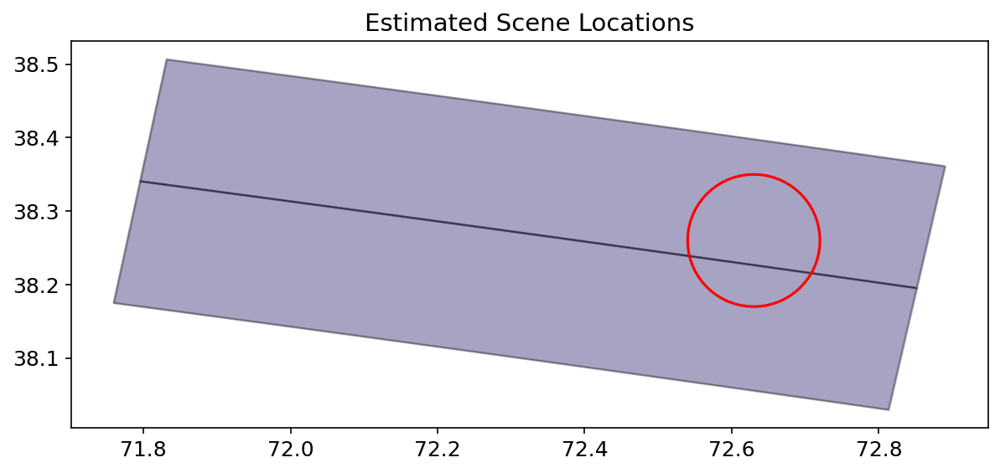

In [22]:
sbas.plot_scenes(AOI=AOI)

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

In [23]:
sbas.compute_reframe(AOI)

Reframing: 01...16 from 19:   0%|          | 0/16 [00:00<?, ?it/s]

Reframing: 17...19 from 19:   0%|          | 0/3 [00:00<?, ?it/s]

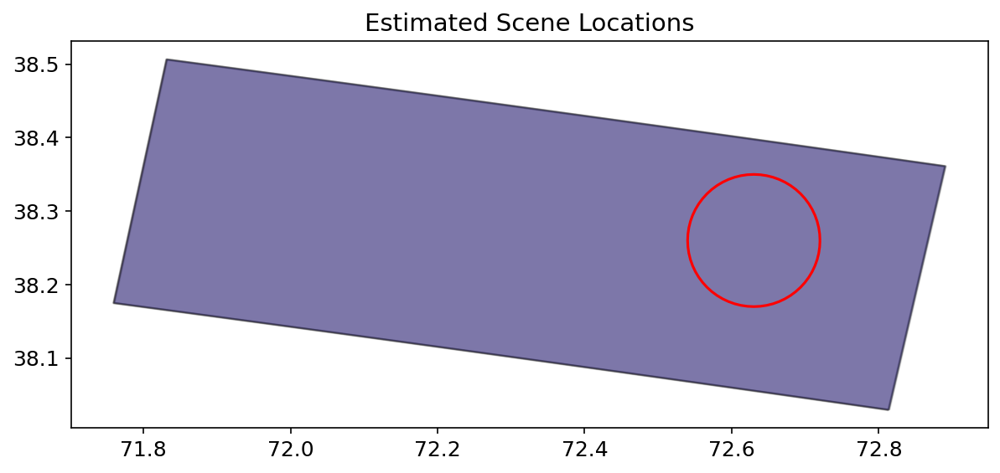

In [24]:
sbas.plot_scenes(AOI=AOI)

### Load DEM

The function below loads DEM from file or Xarray variable and converts heights to ellipsoidal model using EGM96 grid.

In [25]:
# define the area of interest (AOI) to speedup the processing
sbas.load_dem(DEM, AOI)

Save DEM on WGS84 Ellipsoid:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

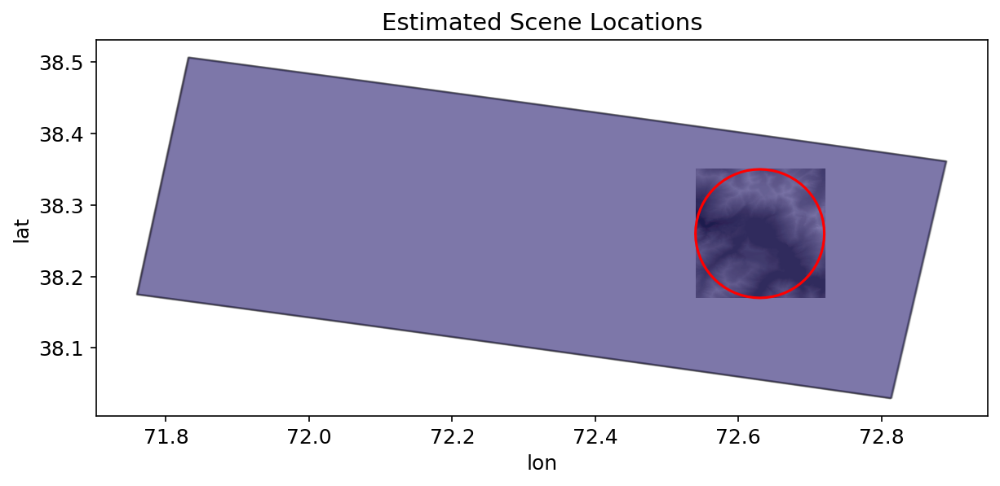

In [26]:
sbas.plot_scenes(AOI=AOI)

## Align Images

In [27]:
sbas.compute_align()

Preparing Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/18 [00:00<?, ?it/s]

## Geocoding Transform

In [28]:
# use the original Sentinel-1 resolution (1 pixel spacing)
sbas.compute_geocode(1)

Radar Transform Computing:   0%|          | 0/2 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

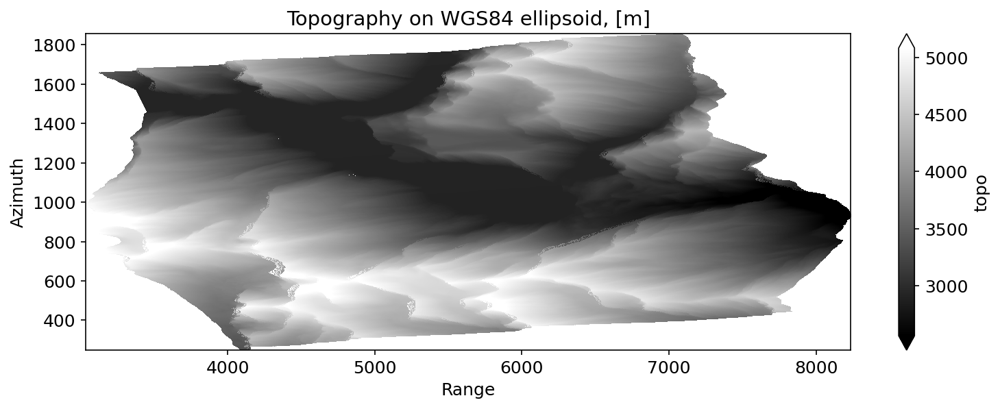

In [29]:
sbas.plot_topo(quantile=[0.01, 0.99])

## Persistent Scatterers Function (PSF)

In [30]:
# use the only selected dates for the pixels stability analysis
sbas.compute_ps()

Intensity Normalization:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Compute Stability Measures:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

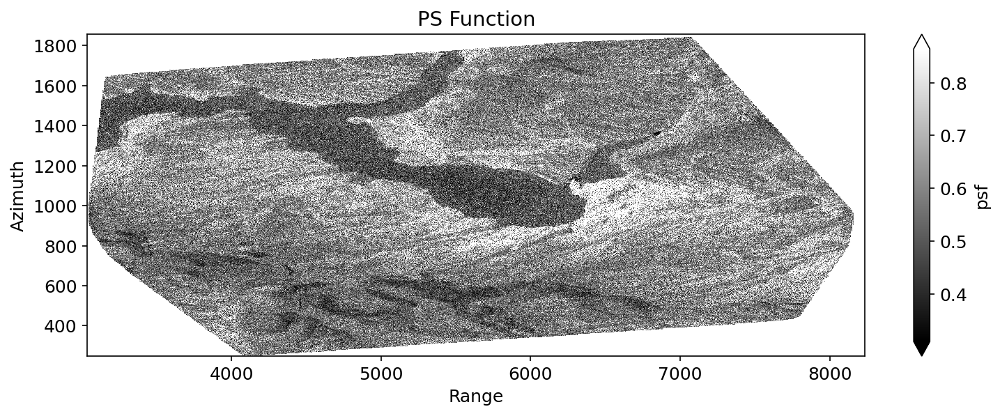

In [31]:
sbas.plot_psfunction(quantile=[0.01, 0.90])

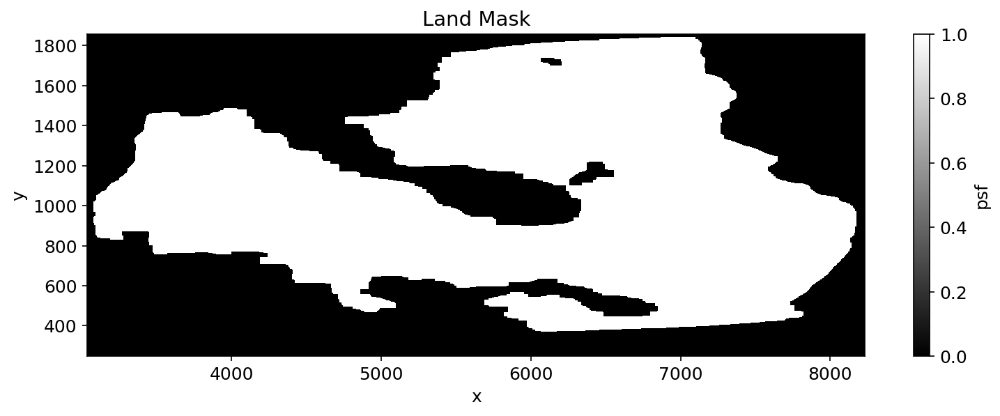

In [32]:
psmask_sbas = sbas.multilooking(sbas.psfunction(), coarsen=(1,4), wavelength=100)>0.5
topo_sbas = sbas.get_topo().interp_like(psmask_sbas, method='nearest')
landmask_sbas = psmask_sbas&(np.isfinite(topo_sbas))
landmask_sbas = utils.binary_opening(landmask_sbas, structure=np.ones((20,20)))
landmask_sbas = np.isfinite(sbas.conncomp_main(landmask_sbas))
landmask_sbas = utils.binary_closing(landmask_sbas, structure=np.ones((20,20)))
landmask_sbas = np.isfinite(psmask_sbas.where(landmask_sbas))
sbas.plot_landmask(landmask_sbas)

## SBAS Baseline

In [33]:
baseline_pairs = sbas.sbas_pairs(days=60)
# optionally, drop dates having less then 2 pairs
#baseline_pairs = sbas.sbas_pairs_limit(baseline_pairs, limit=2, iterations=2)
# optionally, drop all pairs connected to the specified dates
#baseline_pairs = sbas.sbas_pairs_filter_dates(baseline_pairs, ['2021-01-01'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel
0,2017-05-11,2017-05-23,62.72,25.46,2017-05-11 2017-05-23,-37.26,12,NaT
1,2017-05-11,2017-06-04,62.72,-19.18,2017-05-11 2017-06-04,-81.90,24,NaT
2,2017-05-11,2017-06-16,62.72,-52.67,2017-05-11 2017-06-16,-115.39,36,NaT
3,2017-05-11,2017-07-10,62.72,8.47,2017-05-11 2017-07-10,-54.25,60,NaT
4,2017-05-23,2017-06-04,25.46,-19.18,2017-05-23 2017-06-04,-44.64,12,NaT
5,2017-05-23,2017-06-16,25.46,-52.67,2017-05-23 2017-06-16,-78.13,24,NaT
6,2017-05-23,2017-07-10,25.46,8.47,2017-05-23 2017-07-10,-16.99,48,NaT
7,2017-05-23,2017-07-22,25.46,-8.63,2017-05-23 2017-07-22,-34.09,60,NaT
8,2017-06-04,2017-06-16,-19.18,-52.67,2017-06-04 2017-06-16,-33.49,12,NaT
9,2017-06-04,2017-07-10,-19.18,8.47,2017-06-04 2017-07-10,27.65,36,NaT


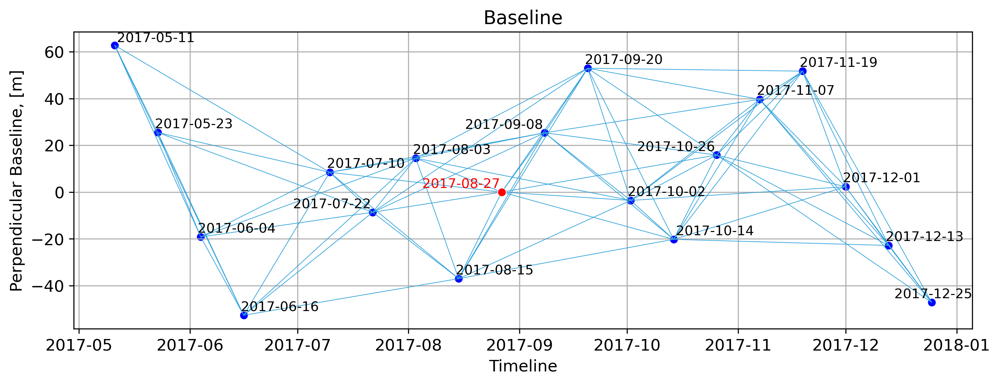

In [34]:
with mpl_settings({'figure.dpi': 300}):
    sbas.plot_baseline(baseline_pairs)

## SBAS Analysis

### Multi-looked Resolution for SBAS

In [35]:
sbas.compute_interferogram_multilook(baseline_pairs, 'intf_mlook', wavelength=200, psize=32,
                                     weight=sbas.psfunction())

Saving Interferogram 01...16 from 76:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 17...32 from 76:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 33...48 from 76:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 49...64 from 76:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 65...76 from 76:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [36]:
# optionally, materialize to disk and open
ds_sbas = sbas.open_stack('intf_mlook')
# apply land mask
ds_sbas = ds_sbas.where(landmask_sbas)
intf_sbas = ds_sbas.phase
corr_sbas = ds_sbas.correlation
corr_sbas

<xarray.DataArray 'correlation' (pair: 76, y: 1609, x: 1299)> Size: 635MB
dask.array<where, shape=(76, 1609, 1299), dtype=float32, chunksize=(1, 1609, 1299), chunktype=numpy.ndarray>
Coordinates:
    ref      (pair) datetime64[ns] 608B 2017-05-11 2017-05-11 ... 2017-12-13
    rep      (pair) datetime64[ns] 608B 2017-05-23 2017-06-04 ... 2017-12-25
  * pair     (pair) <U21 6kB '2017-05-11 2017-05-23' ... '2017-12-13 2017-12-25'
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03
  * x        (x) float64 10kB 3.039e+03 3.043e+03 ... 8.227e+03 8.231e+03

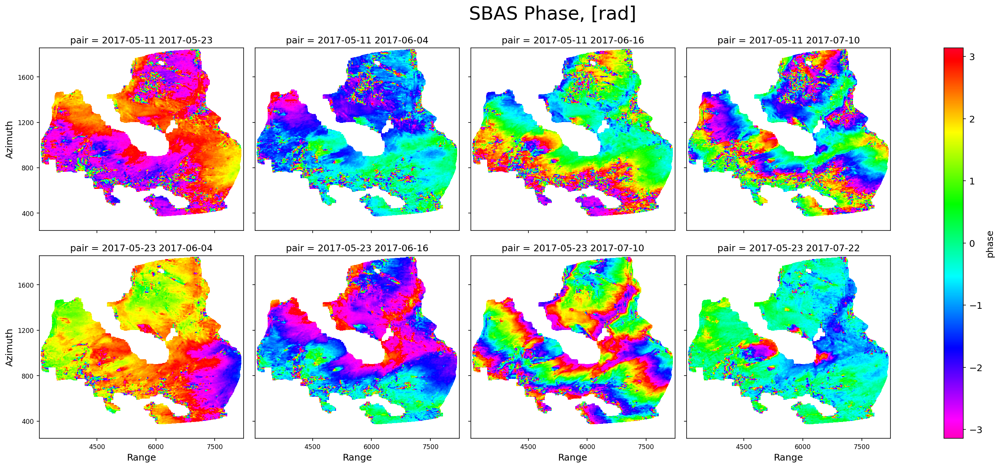

In [37]:
sbas.plot_interferograms(intf_sbas[:8], caption='SBAS Phase, [rad]')

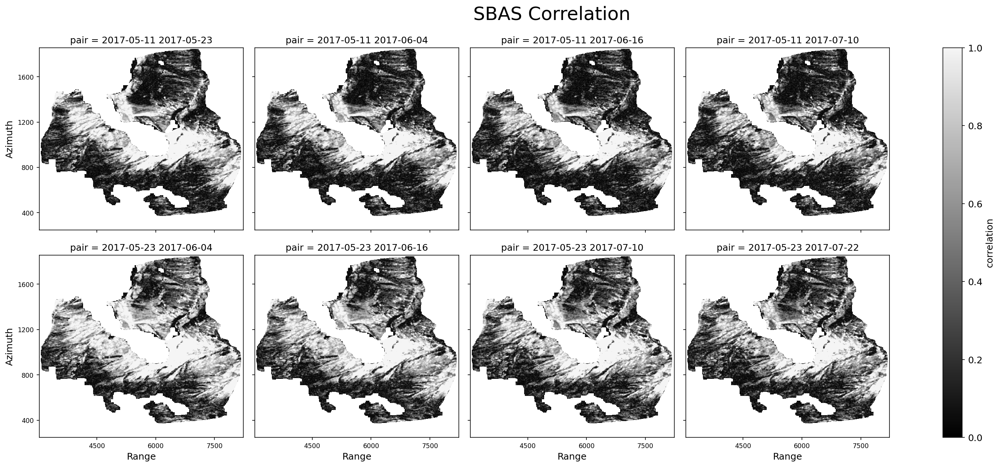

In [38]:
sbas.plot_correlations(corr_sbas[:8], caption='SBAS Correlation')

### Quality Check

In [39]:
#baseline_pairs['corr'] = corr_sbas.sel(pair=baseline_pairs.pair.values).mean(['y', 'x'])
baseline_pairs['corr'] = corr_sbas.mean(['y', 'x'])
print (len(baseline_pairs))
baseline_pairs

76


,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel,corr
0,2017-05-11,2017-05-23,62.72,25.46,2017-05-11 2017-05-23,-37.26,12,NaT,0.445462
1,2017-05-11,2017-06-04,62.72,-19.18,2017-05-11 2017-06-04,-81.90,24,NaT,0.406924
2,2017-05-11,2017-06-16,62.72,-52.67,2017-05-11 2017-06-16,-115.39,36,NaT,0.373237
3,2017-05-11,2017-07-10,62.72,8.47,2017-05-11 2017-07-10,-54.25,60,NaT,0.375157
4,2017-05-23,2017-06-04,25.46,-19.18,2017-05-23 2017-06-04,-44.64,12,NaT,0.548197
5,2017-05-23,2017-06-16,25.46,-52.67,2017-05-23 2017-06-16,-78.13,24,NaT,0.489986
6,2017-05-23,2017-07-10,25.46,8.47,2017-05-23 2017-07-10,-16.99,48,NaT,0.481759
7,2017-05-23,2017-07-22,25.46,-8.63,2017-05-23 2017-07-22,-34.09,60,NaT,0.448768
8,2017-06-04,2017-06-16,-19.18,-52.67,2017-06-04 2017-06-16,-33.49,12,NaT,0.621081
9,2017-06-04,2017-07-10,-19.18,8.47,2017-06-04 2017-07-10,27.65,36,NaT,0.538643


In [40]:
pairs_best = sbas.sbas_pairs_covering_correlation(baseline_pairs, 2)
print (len(pairs_best))
pairs_best

32


,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel,corr
0,2017-05-11,2017-05-23,62.72,25.46,2017-05-11 2017-05-23,-37.26,12,NaT,0.445462
1,2017-05-11,2017-06-04,62.72,-19.18,2017-05-11 2017-06-04,-81.90,24,NaT,0.406924
2,2017-05-23,2017-06-04,25.46,-19.18,2017-05-23 2017-06-04,-44.64,12,NaT,0.548197
3,2017-05-23,2017-06-16,25.46,-52.67,2017-05-23 2017-06-16,-78.13,24,NaT,0.489986
4,2017-06-04,2017-06-16,-19.18,-52.67,2017-06-04 2017-06-16,-33.49,12,NaT,0.621081
5,2017-06-04,2017-07-22,-19.18,-8.63,2017-06-04 2017-07-22,10.55,48,NaT,0.545370
6,2017-06-16,2017-07-10,-52.67,8.47,2017-06-16 2017-07-10,61.14,24,NaT,0.563508
7,2017-06-16,2017-07-22,-52.67,-8.63,2017-06-16 2017-07-22,44.04,36,NaT,0.570718
8,2017-07-10,2017-07-22,8.47,-8.63,2017-07-10 2017-07-22,-17.10,12,NaT,0.717021
9,2017-07-10,2017-08-03,8.47,14.50,2017-07-10 2017-08-03,6.03,24,NaT,0.701044


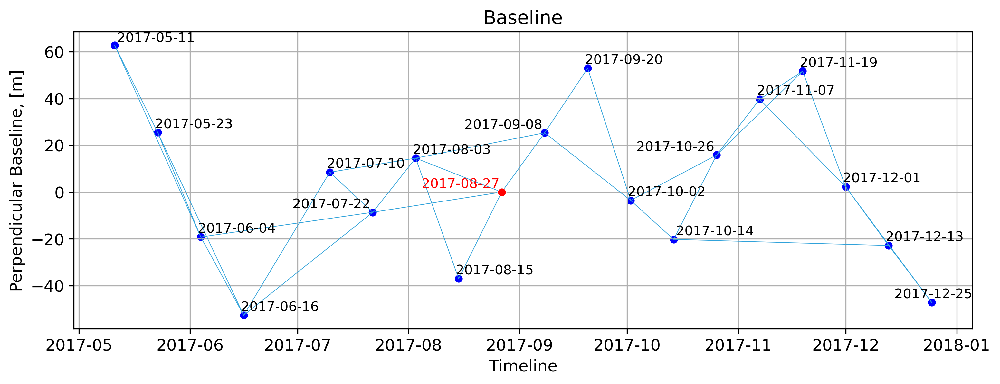

In [41]:
with mpl_settings({'figure.dpi': 300}):
    sbas.plot_baseline(pairs_best)

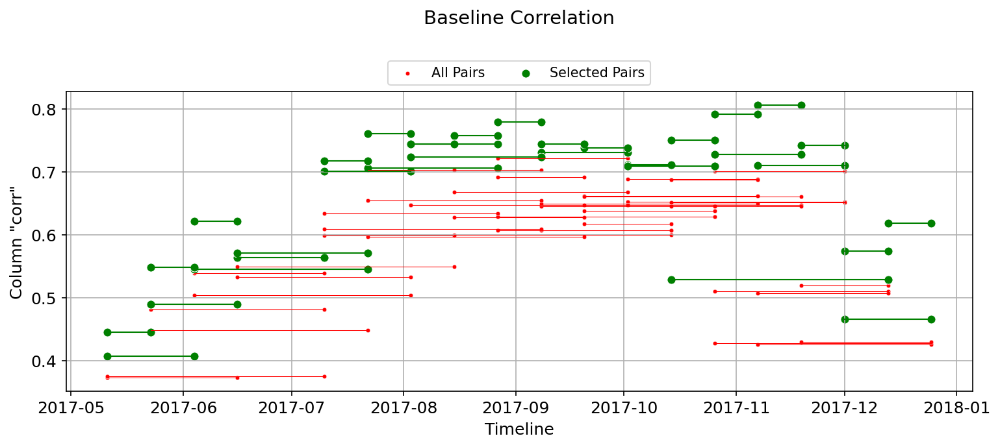

In [42]:
sbas.plot_baseline_correlation(baseline_pairs, pairs_best)

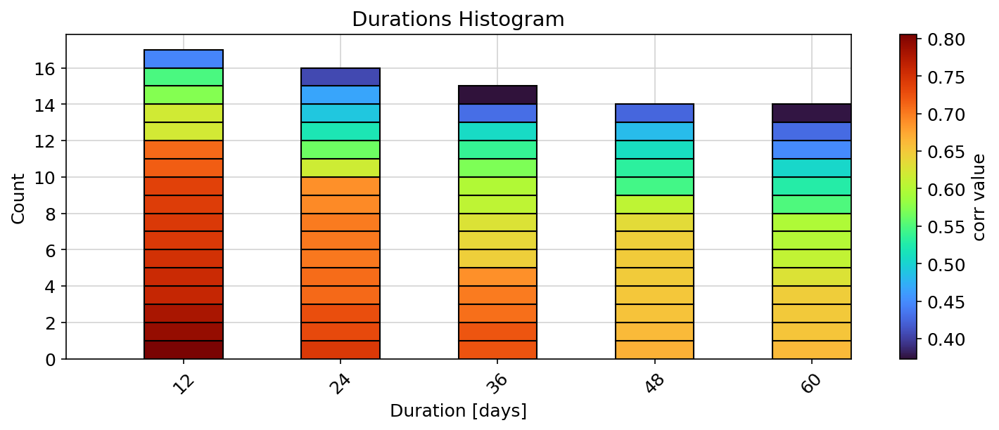

In [43]:
sbas.plot_baseline_duration(baseline_pairs, column='corr', ascending=False)

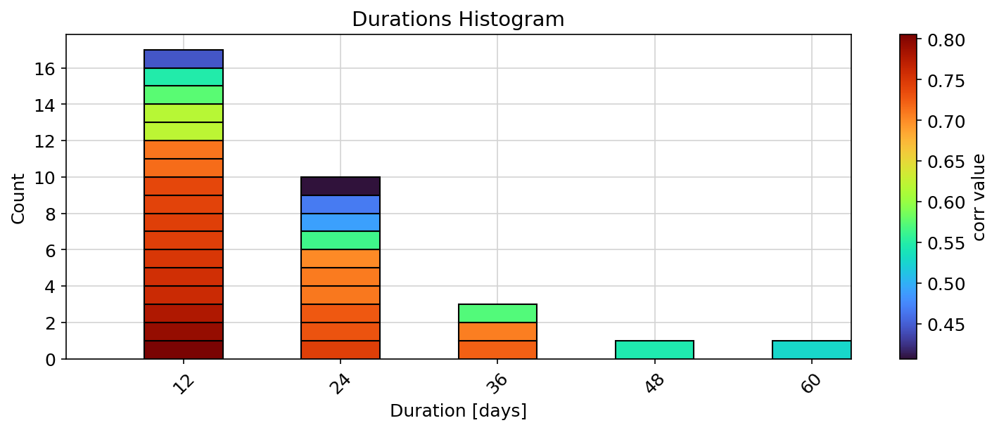

In [44]:
sbas.plot_baseline_duration(pairs_best, column='corr', ascending=False)

In [45]:
intf_sbas = intf_sbas.sel(pair=pairs_best.pair.values)
corr_sbas = corr_sbas.sel(pair=pairs_best.pair.values)

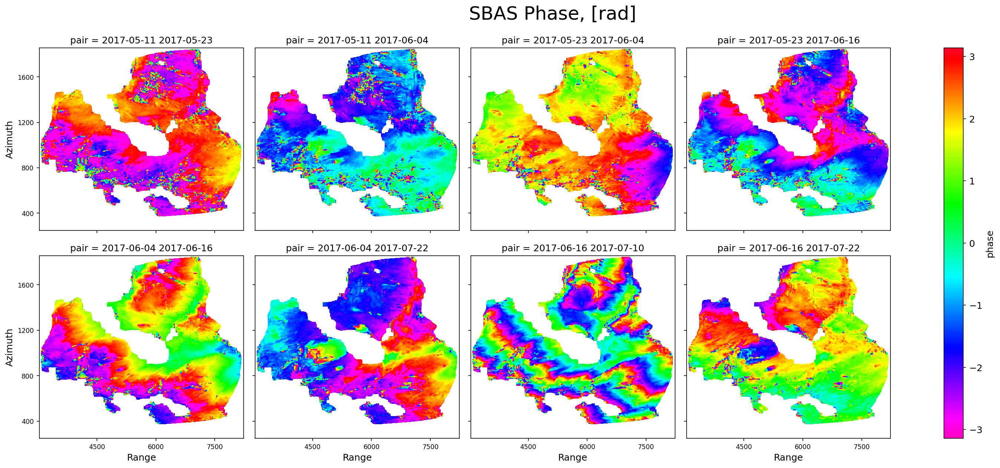

In [46]:
sbas.plot_interferograms(intf_sbas[:8], caption='SBAS Phase, [rad]')

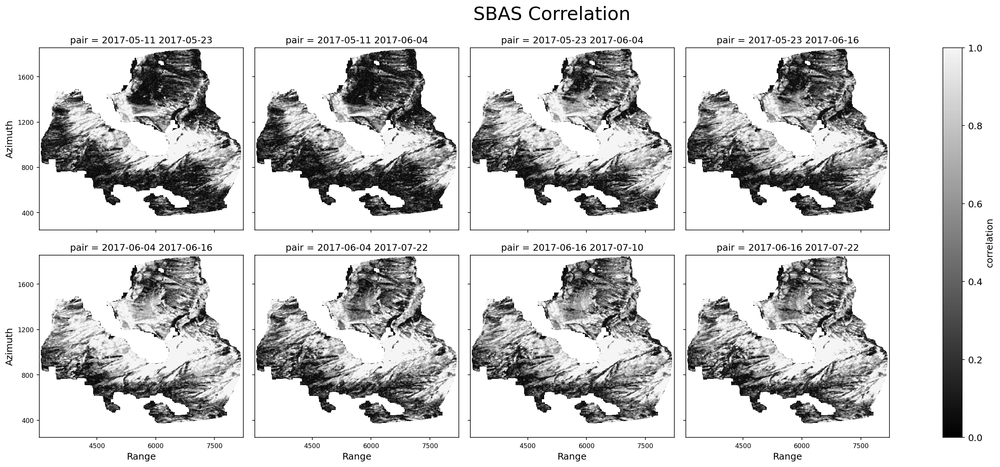

In [47]:
sbas.plot_correlations(corr_sbas[:8], caption='SBAS Correlation')

### 2D Unwrapping

In [48]:
corr_sbas_stack = corr_sbas.mean('pair')

In [49]:
corr_sbas_stack = sbas.sync_cube(corr_sbas_stack, 'corr_sbas_stack')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

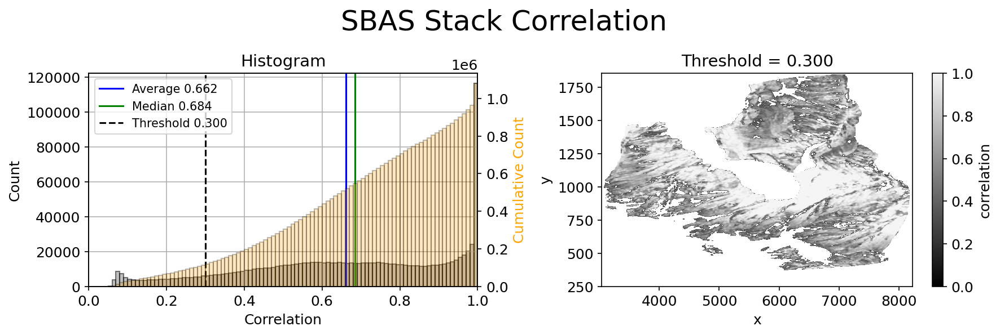

In [50]:
sbas.plot_correlation_stack(corr_sbas_stack, CORRLIMIT := 0.3, caption='SBAS Stack Correlation')

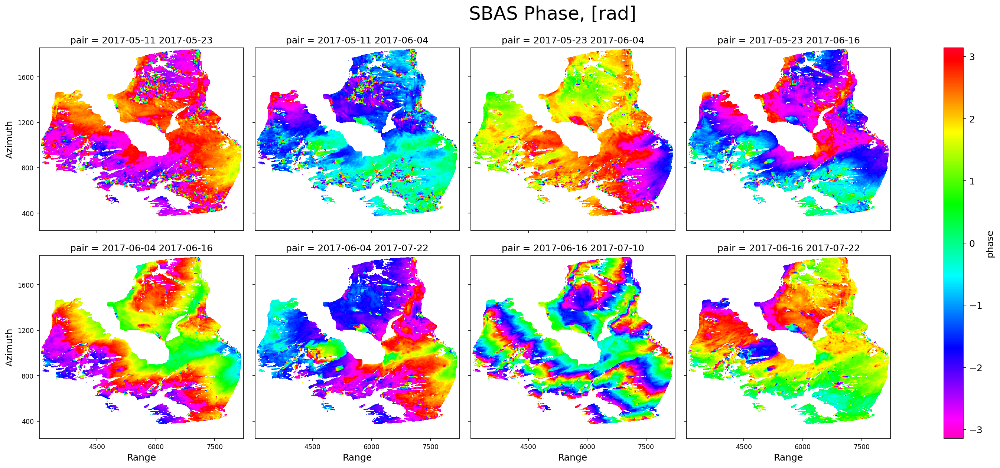

In [51]:
sbas.plot_interferograms(intf_sbas[:8].where(corr_sbas_stack>CORRLIMIT), caption='SBAS Phase, [rad]')

In [52]:
unwrap_sbas = sbas.unwrap_snaphu(
    intf_sbas.where(corr_sbas_stack>CORRLIMIT),
    corr_sbas,
    conncomp=True
)
unwrap_sbas

<xarray.Dataset> Size: 535MB
Dimensions:   (pair: 32, y: 1609, x: 1299)
Coordinates:
    ref       (pair) datetime64[ns] 256B 2017-05-11 2017-05-11 ... 2017-12-13
    rep       (pair) datetime64[ns] 256B 2017-05-23 2017-06-04 ... 2017-12-25
  * pair      (pair) <U21 3kB '2017-05-11 2017-05-23' ... '2017-12-13 2017-12...
  * y         (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03
  * x         (x) float64 10kB 3.039e+03 3.043e+03 ... 8.227e+03 8.231e+03
Data variables:
    phase     (pair, y, x) float32 268MB dask.array<chunksize=(1, 1609, 1299), meta=np.ndarray>
    conncomp  (pair, y, x) float32 268MB dask.array<chunksize=(1, 1609, 1299), meta=np.ndarray>

In [53]:
# optionally, materialize to disk and open
unwrap_sbas = sbas.sync_cube(unwrap_sbas, 'unwrap_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

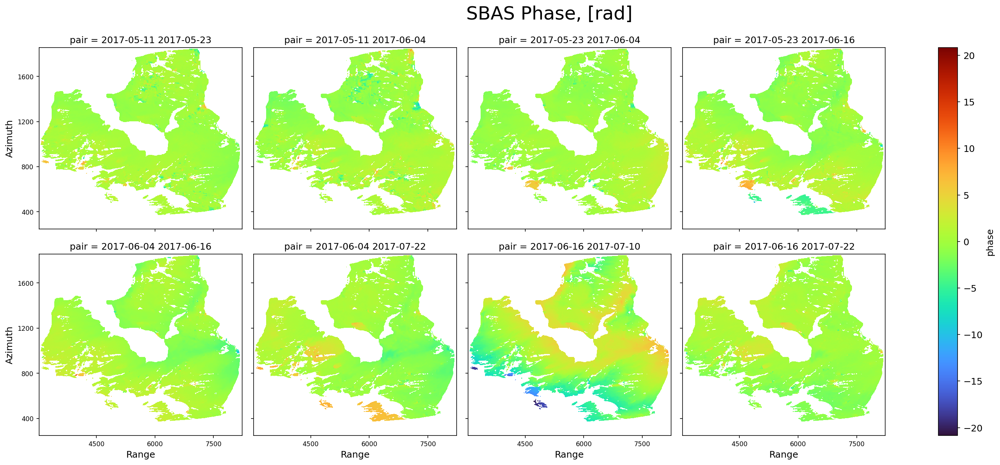

In [54]:
sbas.plot_phases((unwrap_sbas.phase - unwrap_sbas.phase.mean(['y','x']))[:8], caption='SBAS Phase, [rad]')

In [55]:
# select the main valid component
unwrap_sbas = sbas.conncomp_main(unwrap_sbas, 1)

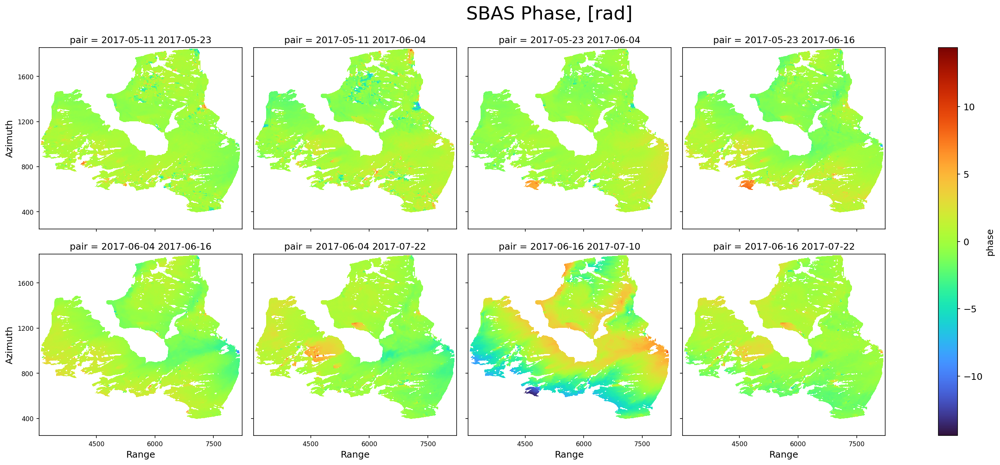

In [56]:
sbas.plot_phases((unwrap_sbas.phase - unwrap_sbas.phase.mean(['y','x']))[:8], caption='SBAS Phase, [rad]')

### Trend Correction

In [57]:
decimator_sbas = sbas.decimator(resolution=15, grid=(1,1))
topo = decimator_sbas(sbas.get_topo())
yy, xx = xr.broadcast(topo.y, topo.x)
trend_sbas = sbas.regression(unwrap_sbas.phase,
        [topo,    topo*yy,    topo*xx,    topo*yy*xx,
         topo**2, topo**2*yy, topo**2*xx, topo**2*yy*xx,
         yy, xx, yy*xx], corr_sbas)

In [58]:
# optionally, materialize to disk and open
trend_sbas = sbas.sync_cube(trend_sbas, 'trend_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

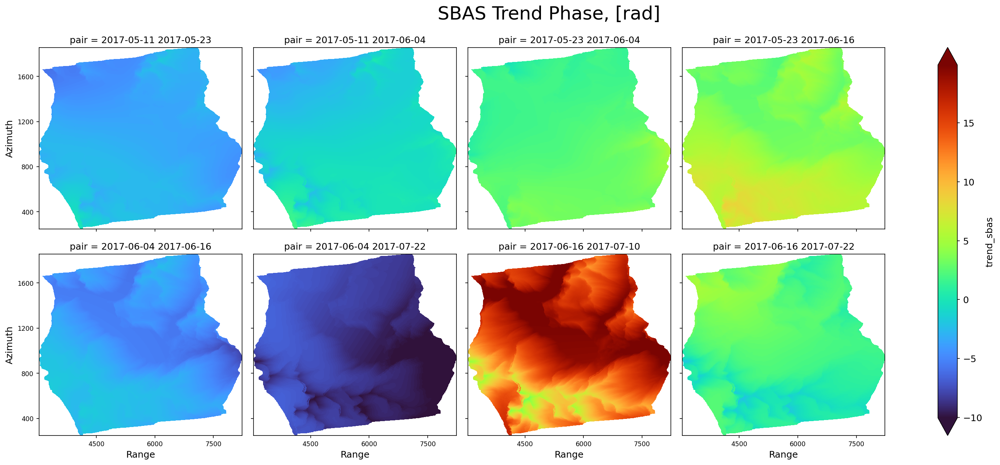

In [59]:
sbas.plot_phases(trend_sbas[:8], caption='SBAS Trend Phase, [rad]', quantile=[0.01, 0.99])

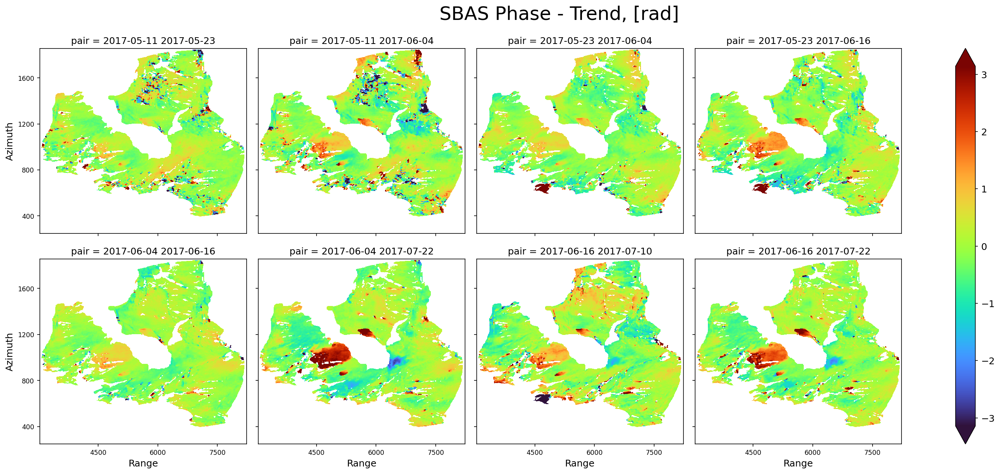

In [60]:
sbas.plot_phases((unwrap_sbas.phase - trend_sbas)[:8], caption='SBAS Phase - Trend, [rad]', vmin=-np.pi, vmax=np.pi)

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [61]:
# calculate phase displacement in radians and convert to LOS displacement in millimeter
disp_sbas = sbas.los_displacement_mm(sbas.lstsq(unwrap_sbas.phase - trend_sbas, corr_sbas))

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


In [62]:
# optionally, materialize to disk and open
disp_sbas = sbas.sync_cube(disp_sbas, 'disp_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

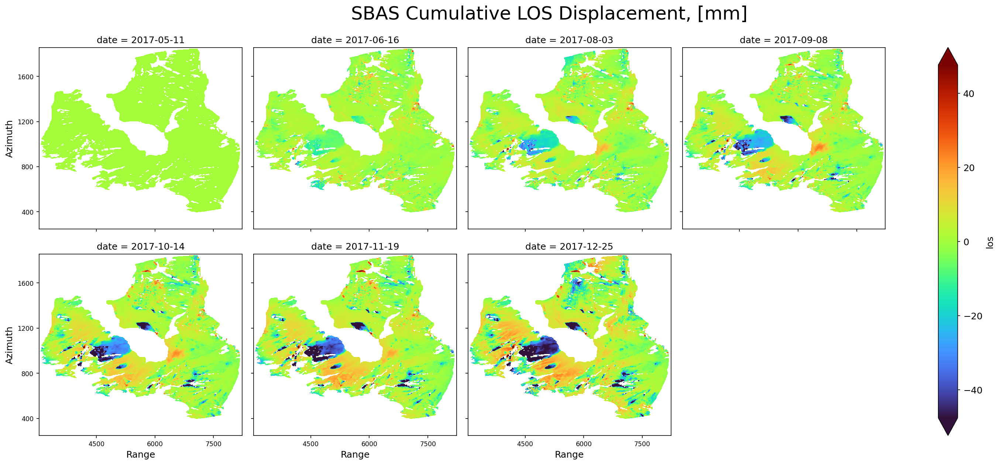

In [63]:
sbas.plot_displacements(disp_sbas[::3], caption='SBAS Cumulative LOS Displacement, [mm]',
                        quantile=[0.01, 0.99], symmetrical=True)

### Least-squares model for LOS Displacement, mm

In [64]:
velocity_sbas = sbas.velocity(disp_sbas)
velocity_sbas

<xarray.DataArray 'trend' (y: 1609, x: 1299)> Size: 8MB
dask.array<mul, shape=(1609, 1299), dtype=float32, chunksize=(1609, 1299), chunktype=numpy.ndarray>
Coordinates:
    degree   int64 8B 1
  * x        (x) float64 10kB 3.039e+03 3.043e+03 ... 8.227e+03 8.231e+03
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03

In [65]:
# optionally, materialize to disk and open
velocity_sbas = sbas.sync_cube(velocity_sbas, 'velocity_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

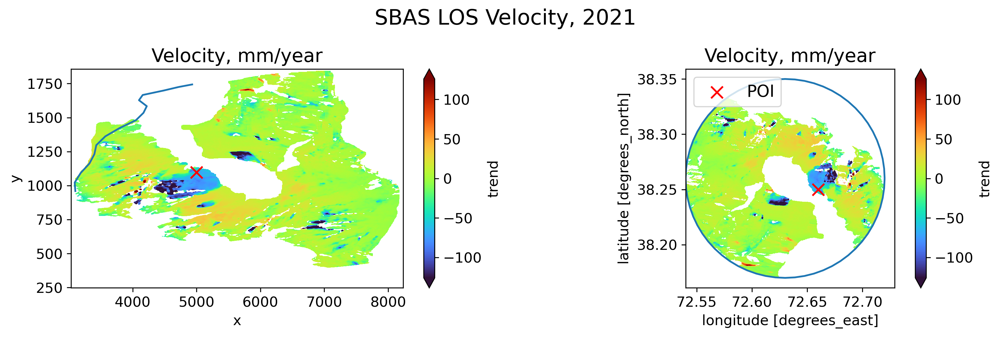

In [66]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_sbas, [0.01, 0.99])
zminmax = max(abs(zmin), zmax)

ax = fig.add_subplot(1, 2, 1)
velocity_sbas.plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
sbas.geocode(AOI.boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
ax.set_aspect('auto')
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry)\
    .plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
AOI.boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('SBAS LOS Velocity, 2021', fontsize=18)
plt.tight_layout()
plt.show()

### STL model for LOS Displacement, mm

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


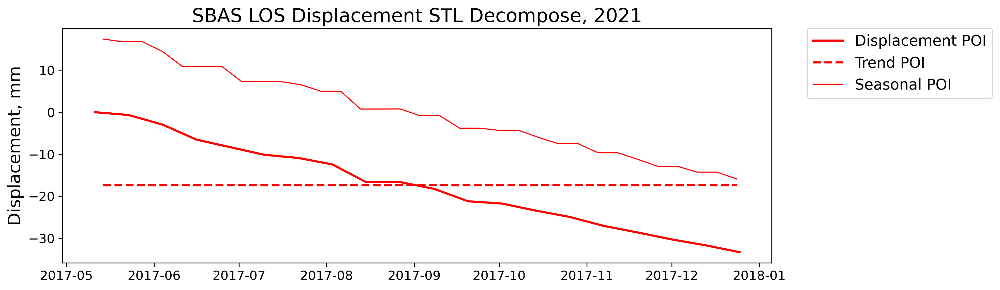

In [67]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_sbas.sel(y=y, x=x, method='nearest')
stl_pixel = sbas.stl(disp_sbas.sel(y=[y], x=[x], method='nearest')).isel(x=0, y=0)
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title('SBAS LOS Displacement STL Decompose, 2021', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.show()

## PS Analysis

Use the trend detected on possibly lower resolution unwrapped phases for higher resolution analysis.

In [68]:
stability = sbas.psfunction()
landmask_ps = landmask_sbas.astype(int).interp_like(stability, method='nearest').astype(bool)
sbas.compute_interferogram_singlelook(pairs_best, 'intf_slook', wavelength=60,
                                      weight=stability.where(landmask_ps), phase=trend_sbas)

Saving Interferogram 01...16 from 32:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 17...32 from 32:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [69]:
# optionally, materialize to disk and open
ds_ps = sbas.open_stack('intf_slook')
intf_ps = ds_ps.phase
corr_ps = ds_ps.correlation

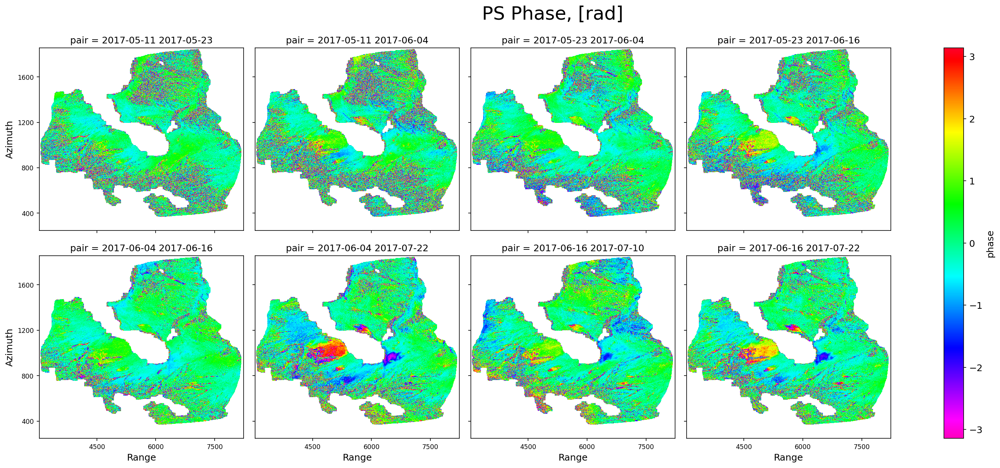

In [70]:
sbas.plot_interferograms(intf_ps[:8], caption='PS Phase, [rad]')

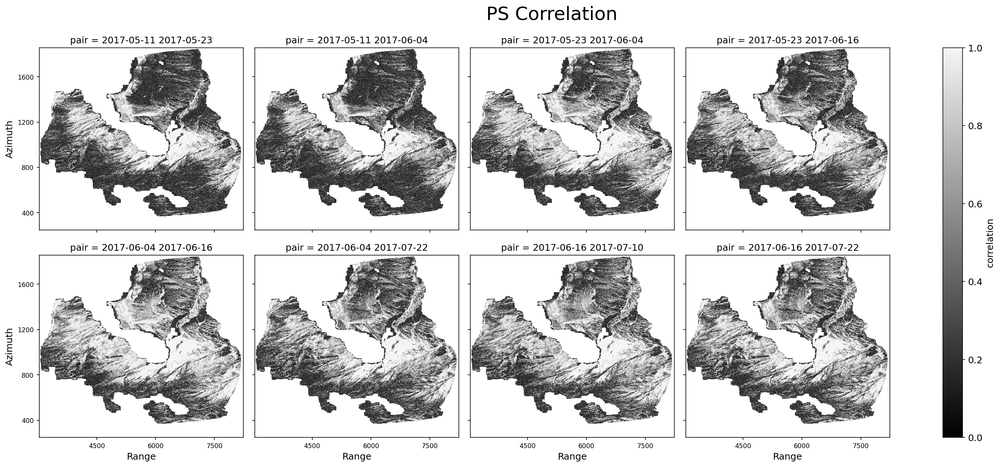

In [71]:
sbas.plot_correlations(corr_ps[:8], caption='PS Correlation')

### 1D Unwrapping and LOS Displacement, mm

In [72]:
disp_ps_pairs = sbas.los_displacement_mm(sbas.unwrap1d(intf_ps))
disp_ps_pairs

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'los' (pair: 32, y: 1609, x: 5199)> Size: 1GB
dask.array<mul, shape=(32, 1609, 5199), dtype=float32, chunksize=(32, 256, 256), chunktype=numpy.ndarray>
Coordinates:
    ref      (pair) datetime64[ns] 256B dask.array<chunksize=(32,), meta=np.ndarray>
    rep      (pair) datetime64[ns] 256B dask.array<chunksize=(32,), meta=np.ndarray>
  * pair     (pair) <U21 3kB '2017-05-11 2017-05-23' ... '2017-12-13 2017-12-25'
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03
  * x        (x) float64 42kB 3.038e+03 3.038e+03 ... 8.234e+03 8.236e+03

In [73]:
# optionally, materialize to disk and open
disp_ps_pairs = sbas.sync_cube(disp_ps_pairs, 'disp_ps_pairs')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [74]:
disp_ps = sbas.lstsq(disp_ps_pairs, corr_ps)
disp_ps

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'displacement' (date: 19, y: 1609, x: 5199)> Size: 636MB
dask.array<concatenate, shape=(19, 1609, 5199), dtype=float32, chunksize=(19, 256, 256), chunktype=numpy.ndarray>
Coordinates:
  * date     (date) datetime64[ns] 152B 2017-05-11 2017-05-23 ... 2017-12-25
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03
  * x        (x) float64 42kB 3.038e+03 3.038e+03 ... 8.234e+03 8.236e+03

In [75]:
# optionally, materialize to disk and open
disp_ps = sbas.sync_cube(disp_ps, 'disp_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

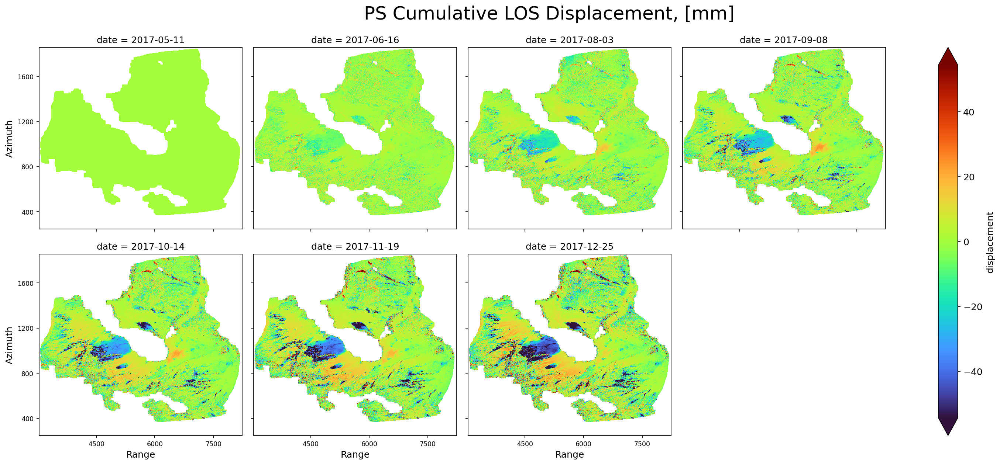

In [76]:
sbas.plot_displacements(disp_ps[::3], caption='PS Cumulative LOS Displacement, [mm]',
                        quantile=[0.01, 0.99], symmetrical=True)

### Least-squares model for LOS Displacement, mm

In [77]:
velocity_ps = sbas.velocity(disp_ps)
velocity_ps

<xarray.DataArray 'trend' (y: 1609, x: 5199)> Size: 33MB
dask.array<mul, shape=(1609, 5199), dtype=float32, chunksize=(537, 5199), chunktype=numpy.ndarray>
Coordinates:
    degree   int64 8B 1
  * x        (x) float64 42kB 3.038e+03 3.038e+03 ... 8.234e+03 8.236e+03
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03

In [78]:
# optionally, materialize to disk and open
velocity_ps = sbas.sync_cube(velocity_ps, 'velocity_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

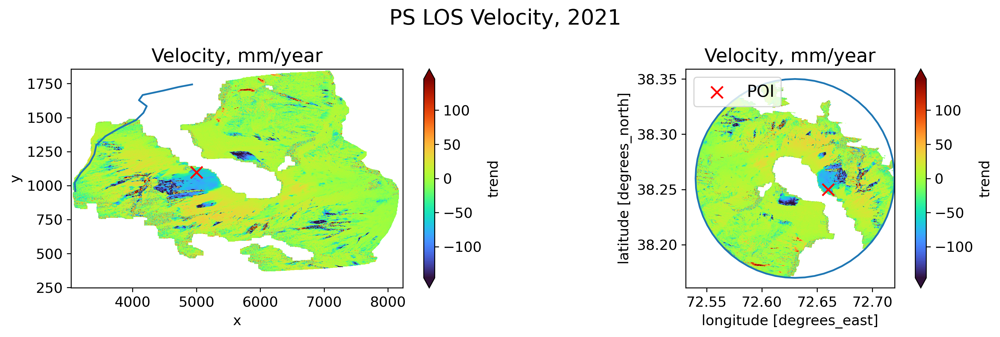

In [79]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_ps, [0.01, 0.99])
zminmax = max(abs(zmin), zmax)

ax = fig.add_subplot(1, 2, 1)
velocity_ps.plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
sbas.geocode(AOI.boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
ax.set_aspect('auto')
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry)\
    .plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
AOI.boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('PS LOS Velocity, 2021', fontsize=18)
plt.tight_layout()
plt.show()

### STL model for LOS Displacement, mm

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


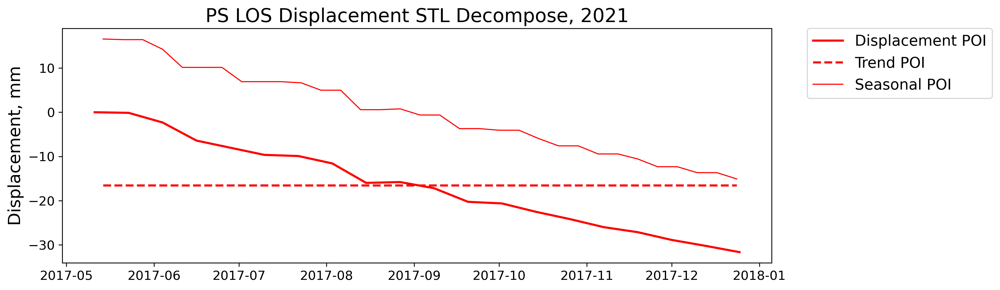

In [80]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = sbas.stl(disp_ps.sel(y=[y], x=[x], method='nearest')).isel(x=0, y=0)
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title('PS LOS Displacement STL Decompose, 2021', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.show()

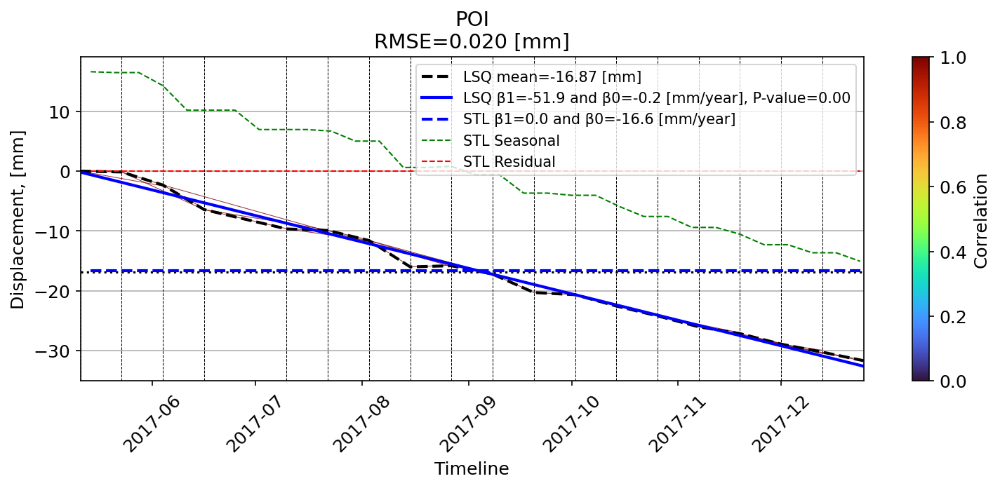

In [81]:
x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI).geometry][0]
sbas.plot_baseline_displacement_los_mm(disp_ps_pairs.sel(y=y, x=x, method='nearest')/sbas.los_displacement_mm(1),
                                corr_ps.sel(y=y, x=x, method='nearest'),
                               caption='POI', stl=True)

### RMSE Error Estimation

In [82]:
rmse_ps = sbas.rmse(disp_ps_pairs, disp_ps, corr_ps)
rmse_ps

<xarray.DataArray 'rmse' (y: 1609, x: 5199)> Size: 33MB
dask.array<sqrt, shape=(1609, 5199), dtype=float32, chunksize=(1609, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 13kB 248.5 249.5 250.5 ... 1.856e+03 1.856e+03
  * x        (x) float64 42kB 3.038e+03 3.038e+03 ... 8.234e+03 8.236e+03

In [83]:
# optionally, materialize to disk and open
rmse_ps = sbas.sync_cube(rmse_ps, 'rmse_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

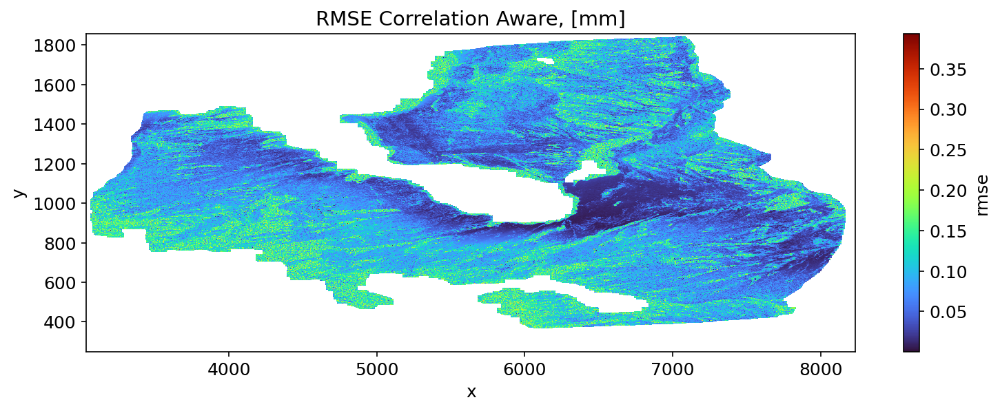

In [84]:
sbas.plot_rmse(rmse_ps, caption='RMSE Correlation Aware, [mm]')

## SBAS vs PS Comparision

In [85]:
# crop AOI
points_sbas = sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry)
points_ps = sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry)
points_ps = points_ps.interp_like(points_sbas, method='nearest').values.ravel()
points_sbas = points_sbas.values.ravel()
nanmask = np.isnan(points_sbas) | np.isnan(points_ps)
points_sbas = points_sbas[~nanmask]
points_ps = points_ps[~nanmask]

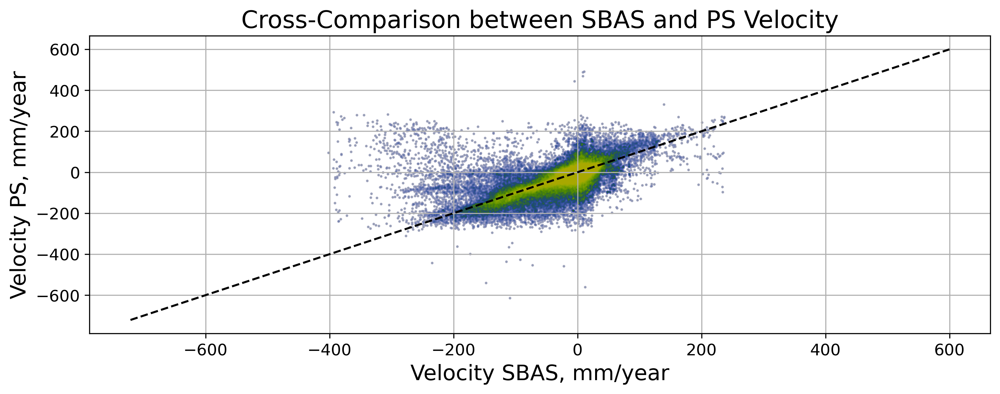

In [86]:
plt.figure(figsize=(12, 4), dpi=300)
plt.scatter(points_sbas, points_ps, c='silver', alpha=1,   s=1)
plt.scatter(points_sbas, points_ps, c='b',      alpha=0.1, s=1)
plt.scatter(points_sbas, points_ps, c='g',      alpha=0.1, s=0.1)
plt.scatter(points_sbas, points_ps, c='y',      alpha=0.1, s=0.01)

# adding a 1:1 line
max_value = max(velocity_sbas.max(), velocity_ps.max())
min_value = min(velocity_sbas.min(), velocity_ps.min())
plt.plot([min_value, max_value], [min_value, max_value], 'k--')

plt.xlabel('Velocity SBAS, mm/year', fontsize=16)
plt.ylabel('Velocity PS, mm/year', fontsize=16)
plt.title('Cross-Comparison between SBAS and PS Velocity', fontsize=18)
plt.grid(True)
plt.show()

## 3D Interactive Map

In [87]:
velocity_sbas_ll = sbas.ra2ll(velocity_sbas)
velocity_ps_ll = sbas.ra2ll(velocity_ps)

velocity_sbas_ll = sbas.as_geo(velocity_sbas_ll).rio.clip(AOI.geometry.envelope)
velocity_ps_ll = sbas.as_geo(velocity_ps_ll).rio.clip(AOI.geometry.envelope)

In [88]:
gmap = XYZTiles().download(velocity_sbas_ll, 15)

XYZ Tiles Downloading:   0%|          | 0/378 [00:00<?, ?it/s]

In [89]:
sbas.export_vtk(velocity_sbas_ll[::3,::2], 'velocity_sbas', image=gmap)
sbas.export_vtk(velocity_ps_ll[::3,::8],   'velocity_ps',   image=gmap)

Exporting WGS84 VTK(s):   0%|          | 0/1 [00:00<?, ?it/s]

Exporting WGS84 VTK(s):   0%|          | 0/1 [00:00<?, ?it/s]

In [92]:
plotter = pv.Plotter(shape=(1, 2), notebook=True)
axes = pv.Axes(show_actor=True, actor_scale=2.0, line_width=5)

plotter.subplot(0, 0)
vtk_grid = pv.read('velocity_sbas.vtk')
mesh = vtk_grid.scale([1, 1, 0.00001]).rotate_z(135, point=axes.origin)
plotter.add_mesh(mesh.scale([1, 1, 0.999]), scalars='colors', rgb=True, ambient=0.2)
plotter.add_mesh(mesh, scalars='trend', ambient=0.2, cmap='turbo', clim=(-100,100), nan_opacity=0.1, nan_color='black')
plotter.show_axes()
plotter.add_title('SBAS LOS Velocity', font_size=32)

plotter.subplot(0, 1)
vtk_grid = pv.read('velocity_ps.vtk')
mesh = vtk_grid.scale([1, 1, 0.00001]).rotate_z(135, point=axes.origin)
plotter.add_mesh(mesh.scale([1, 1, 0.999]), scalars='colors', rgb=True, ambient=0.2)
plotter.add_mesh(mesh, scalars='trend', ambient=0.2, cmap='turbo', clim=(-100,100), nan_opacity=0.1, nan_color='black')
plotter.show_axes()
plotter.add_title('PS LOS Velocity', font_size=32)

plotter.show_axes()
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

BokehModel(combine_events=True, render_bundle={'docs_json': {'6d235082-160b-4eee-827d-5764d1221cd2': {'version…

## Export VTK file from Google Colab

In [91]:
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download('velocity_sbas.vtk')
    files.download('velocity_ps.vtk')